In [66]:
import time
#basic imports
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import itertools
#language imports
import re
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
#word modeling
import gensim
from gensim.models import word2vec
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

from sklearn import cluster
from sklearn.model_selection import train_test_split
from sklearn.metrics import silhouette_score
from sklearn.manifold import TSNE

from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, f1_score,confusion_matrix

In [3]:

os.chdir('..')

os.chdir('Thinkful Datasets')

df = pd.read_csv('reddit_comments_cleaned.csv')


In [112]:

df = df[(df['comments'].isnull()== False) & (df['comments']!= 'removed')]

df.head()

,comments,subreddit
0,as a reminder this subreddit is for civil disc...,politics
1,good job kentucky,politics
2,title should be lady who refused to do job los...,politics
3,from what i remember this awful bitch owes the...,politics
4,guess it was gods will,politics


# Model with tags

In [113]:
#Split the df for training and testing
train, test = train_test_split(df.reset_index(drop=True), test_size=.30, random_state=43)

In [12]:
def read_corpus_tag_sub(df,corp='comments',tags='subreddit',tokens_only=False):
    df=df.reset_index(drop=True)
    for i, line in enumerate(df[corp]):
        if tokens_only:
            yield gensim.utils.simple_preprocess(line)
        else:
    
    # For training data, add tags
            yield gensim.models.doc2vec.TaggedDocument(gensim.utils.simple_preprocess(line), df.at[i,tags])

In [114]:
tagged_tr = list(read_corpus_tag_sub(train))

tagged_test =list(read_corpus_tag_sub(test))

In [116]:
doc2vec_model = Doc2Vec(tagged_tr, workers=5, size=50, epochs=50, dm=1)

c:\users\zdwhi\appdata\local\programs\python\python37\lib\site-packages\gensim\models\doc2vec.py:580: UserWarning: The parameter `size` is deprecated, will be removed in 4.0.0, use `vector_size` instead.
  warnings.warn("The parameter `size` is deprecated, will be removed in 4.0.0, use `vector_size` instead.")


In [117]:

train_targets, train_regressors = zip(*[(doc.tags, doc2vec_model.infer_vector(doc.words, steps=20)) for doc in tagged_tr])

test_targets, test_regressors = zip(*[(doc.tags, doc2vec_model.infer_vector(doc.words, steps=20)) for doc in tagged_test])

In [169]:
logreg = LogisticRegression(solver = 'newton-cg',n_jobs=3, C=1e5)
logreg = logreg.fit(train_regressors, train_targets)



c:\users\zdwhi\appdata\local\programs\python\python37\lib\site-packages\sklearn\linear_model\logistic.py:460: FutureWarning:

Default multi_class will be changed to 'auto' in 0.22. Specify the multi_class option to silence this warning.



In [326]:
def sim_word(word):
    return F"{word} is similar to {(doc2vec_model.most_similar(word)[:3])}"

In [351]:
#there are some interesting word associations our model has picked up.

words = ['dossier','healthcare','change','bigot','conspiracy','masculine']

for x in words:
    print(sim_word(x),'\n')


dossier is similar to [('steele', 0.7573274374008179), ('documents', 0.5684577226638794), ('undeniable', 0.5468069911003113)] 

healthcare is similar to [('education', 0.7361563444137573), ('tuition', 0.6253138184547424), ('regulation', 0.6185864210128784)] 

change is similar to [('reflect', 0.6228517293930054), ('alter', 0.6204254031181335), ('focus', 0.5780883431434631)] 

bigot is similar to [('hating', 0.6937345862388611), ('misogynist', 0.693298876285553), ('xenophobe', 0.6930832862854004)] 

conspiracy is similar to [('generalization', 0.5911170244216919), ('prejudice', 0.5569634437561035), ('conjecture', 0.5530405640602112)] 



c:\users\zdwhi\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:2: DeprecationWarning:

Call to deprecated `most_similar` (Method will be removed in 4.0.0, use self.wv.most_similar() instead).



# Results


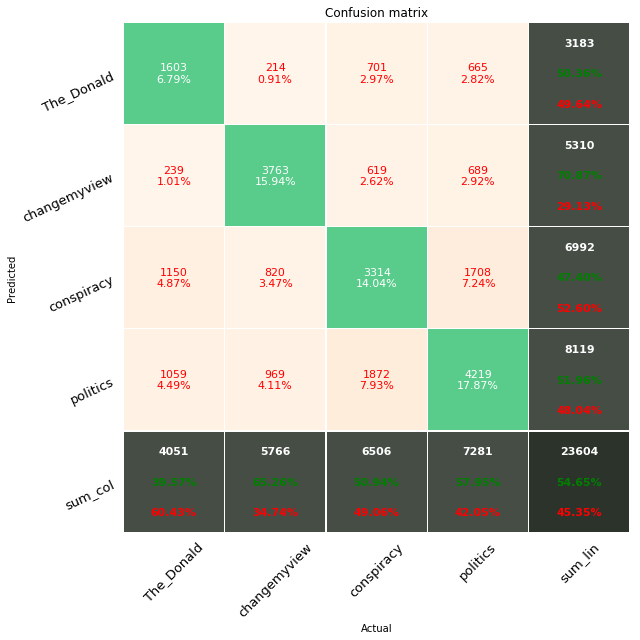

In [168]:

plot_confusion_matrix_from_data(test_targets,logreg.predict(test_regressors),columns=['The_Donald', 'changemyview', 'conspiracy', 'politics'])

In [153]:
conf = pd.DataFrame({'target':test_targets,'pred':logreg.predict(test_regressors)})

In [163]:
conf[conf['pred']=='The_Donald']['target'].value_counts(normalize=True)*100

The_Donald      50.361294
conspiracy      22.023249
politics        20.892240
changemyview     6.723217
Name: target, dtype: float64

In [164]:
conf[conf['pred']=='changemyview']['target'].value_counts(normalize=True)*100

changemyview    70.866290
politics        12.975518
conspiracy      11.657250
The_Donald       4.500942
Name: target, dtype: float64

In [166]:
conf[conf['pred']=='conspiracy']['target'].value_counts()

conspiracy      3314
politics        1708
The_Donald      1150
changemyview     820
Name: target, dtype: int64

In [167]:
conf[conf['pred']=='politics']['target'].value_counts(normalize=True)*100

politics        51.964528
conspiracy      23.057027
The_Donald      13.043478
changemyview    11.934967
Name: target, dtype: float64


## Model Class Performances

**The_Donald**
>The logistic regressor correctly predicted just under 40% of the comments of the total comments from The_Donald. Being that it is the minority class some possible remedies for this more data and better cleaning. Where does this classifier get stumped with respect to classifying these types of comments? ~21% of the time it classifies a comment from politics and conspiracy as a comment from The_Donald and only 6.7% of the time does it think a comment from Changemyview belongs in The_Donald


**Changemyview**
>The changemyview class if by far the easiest class to predict, ~65% of the comments from this community were correctly identified. However, this could be due to not removing comments posted by moderators or bots that are frequent in the sub. When our model is wrong how is it wrong? It's nearly 3 times as likely to predict a comment that is from the politics and conspiracy subreddit as belonging to changemyview as it is The_Donald.


**Conspiracy**
>Classifying comments from conspiracy subbreddit were correct ~51% of the time.  In cases where the classifier predicts the conspiracy class and is wrong, it most often miss classifies comments from politics and to a slightly lesser degree The_Donald.


**Politics**
>Classifying comments from the politics subreddit, our model correctly classified 58% of the total comments from the community. Interesting to note that our classifier is  more than 1.75 times as likely to classify a comment from the conspiracy subreddit as being a comment from politics than classify a comment from The_Donald or changemyview as being from the politics subreddit.

**Overall Observation**
> It is interesting to see when our model incorrectly classifies a comment for The_Donald, Conspiracy, or Politics it is least likely to predict the comment as changemyview. **This is fairly compelling evidence**, that there is a difference between this community and the other three communities. However, this needs to be further shown by removing moderator comments.



In [134]:
%%capture
%run confusion_matrix_pretty_print.py

## Comment Cloud Visualization

In [136]:
### Import plotly
import plotly
import plotly.plotly as py
plotly.tools.set_credentials_file(username='*******', api_key='*******')
import plotly.graph_objs as go
from plotly.offline import iplot
from IPython.display import IFrame


def enable_plotly_in_cell():
  import IPython
  from plotly.offline import init_notebook_mode
  display(IPython.core.display.HTML('''<script src="/static/components/requirejs/require.js"></script>'''))
  init_notebook_mode(connected=False)
    

def plotly_3d(vecs,comments):
    d  = {'x': vecs[:, 0], 'y': vecs[:, 1],'z': vecs[:, 2], 'text':comments['comments'][:],'subreddit':comments['subreddit'][:]}
    df = pd.DataFrame(data=d)

    # Create a trace
    trace_dict = {}
    for i,label in enumerate(comments['subreddit'].unique()):
        trace_dict[i] = go.Scatter3d(
            x = df[df['subreddit']==label]['x'],
            y = df[df['subreddit']==label]['y'],
            z = df[df['subreddit']==label]['z'],
            text = df[df['subreddit']==label]['text'],
            mode='markers',
            marker=dict(
                size=2,
                line=dict(
                    color='rgba('+ str(i*40) + ',' + str(i*40) + ',' + str(i*40) + ', 0.14)',
                    width=0.5
                ),
                opacity=0.8
            ),
            name = label
        )
    data = [item for item in trace_dict.values()]
    layout = go.Layout(
        autosize=False,
        width= 1000,
        height= 1000,
        margin=go.layout.Margin(
            l=20,
            r=20,
            b=20,
            t=20
        )
    )
    #enable_plotly_in_cell()
    fig = go.Figure(data=data, layout=layout)
    py.iplot(data,filename = 'reddit_comments_Test_TSNE_Doc2Vec_tags_vs2')
    #iplot(fig)

The above function takes in a vector of shape [n,3] and a dataframe of shape [n,2] where the two dimmensions are the comment and the subreddit of origin.

In order to take the infered vectors given by our model the data will need to be reduced from a higher dimmensional space to a lower one. In this case I have chosen to use a technique called t-Distributed Stochastic Neighbor Embedding (t-SNE).

If you want a tutorial on t-SNE go [here](https://www.datacamp.com/community/tutorials/introduction-t-sne), if you want to understand its behavior better with some visuals go [here](https://distill.pub/2016/misread-tsne/)

In [131]:
tsne = TSNE(n_components=3, init='pca', random_state=0,verbose = 10)


In [132]:
tsne_df = tsne.fit_transform(test_regressors)

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 23604 samples in 0.056s...
[t-SNE] Computed neighbors for 23604 samples in 59.796s...
[t-SNE] Computed conditional probabilities for sample 1000 / 23604
[t-SNE] Computed conditional probabilities for sample 2000 / 23604
[t-SNE] Computed conditional probabilities for sample 3000 / 23604
[t-SNE] Computed conditional probabilities for sample 4000 / 23604
[t-SNE] Computed conditional probabilities for sample 5000 / 23604
[t-SNE] Computed conditional probabilities for sample 6000 / 23604
[t-SNE] Computed conditional probabilities for sample 7000 / 23604
[t-SNE] Computed conditional probabilities for sample 8000 / 23604
[t-SNE] Computed conditional probabilities for sample 9000 / 23604
[t-SNE] Computed conditional probabilities for sample 10000 / 23604
[t-SNE] Computed conditional probabilities for sample 11000 / 23604
[t-SNE] Computed conditional probabilities for sample 12000 / 23604
[t-SNE] Computed conditional probabilities for sa

In [133]:
### This will load only in Jupyterview or Locally 
plotly_3d(tsne_df,test)

### Discussion of comment clusters

If the plot above does not load, you can access a web version of it hosted directly on plotly [here](https://plot.ly/~zdwhitepdx/4)

Note 1: the axis ARE NOT LABELED!!!!! If this irretates you please go back up and re-read about t-SNE. This is part of the headache when visually evaluating unsupervised learning models in high dimmensional space.

Note 2: Because this plot is interactive I will refer to the home view for a few of my observations or directions on the location of the data. I understand this is janky.

Observations (in no particular order):
 1. Comments seem to be ordered long to short along the y-axis. 
     * Rotate the graphic such that the z-axis is as orthagonal to your screen 
     * Examine 1 subreddit at a time by clicking on their icon in the upper right hand corner
     * We can see the distribution of comments from positive X to negative X the comments get shorter and depending on the community the density shifts. The density for politics and conspiracy is rather centered where changemyview is skewed to the left and The_Donald is skewed to the right.
 2. Comments reveal how bad my text cleaning functions are, but remain interesting to look at.
     * There are very obvious clusters of spam as you navigate around this cloud. One such cluster exists around [x= -37, y = 2 , z = -10]. There are many comments that simply say the letter "f" or the comment is actually a reference to another subreddit (real or fake). The majority of comments in this tight cluster come off as short form sarcasm and inside jokes. For those of you less traveled in the underbelly of the internet the letter "f" simply means to pay your respects and is mostly sarcasm.
     * Another cluster of comments all from the The_Donald around [x=-11 y-26 z=7.54] are simply a collection of spam comments that link to an image website and all spam "Hillary Clinton" in repeated succession. And other clusters that are inside our cloud that are spam links to youtube videos.
     * Filtering only by comments from changemyview, there are very clear groups of comments that all appear to be comments from the subreddits automoderator, which reveals a clear bias in my results.
 3. Exploring around yields some interesting groupings.
     * While it's hard to explain the location. I've found clusters of mentioning the word "upvote" in what appears to be a sarcastic context.


# Conclusion

To conclude this project, I don't believe I have given sufficient evidence to suggest that the three communities of [Politics, The_Donald, and Conspiracy] are significantly similar or distinct with one another. Refering to the 3d visual above, we can see that while there is considerable overlap in the density of comment clouds, I'm unconvinced this is enough to explicitly say the three classes are indistinguishably similar. While, I have shown it is difficult to for my particular modeling pipeline to tell these classes apart, they are classified with greater than naive chance. The two class exceptions for this are the similarity between the conspiracy and political comments and the group of communites vs changemyview.

Given that across all predicted classed the least incorrectly labeled class is the changemyview community comments, it suggests a significant different between the group. These initial results are promising to show that there are differences in how communities on reddit converse with one another. Further steps need to be taken in order to confirm these results.

. The following items are considered "Future Work"

1.Train Multiple models and classifiers
2.Consider finding better tools for cleaning the text
3.Scrape more data
4.Consider weighting comments by the amount of upvotes comments recieved.
5.Account for moderator comments accross all subs




In [137]:
# the previous plot will only load in jupyterview or if you download the notebook
# https://plot.ly/~zdwhitepdx/4

c:\users\zdwhi\appdata\local\programs\python\python37\lib\site-packages\IPython\core\display.py:689: UserWarning:

Consider using IPython.display.IFrame instead

